---
# Background

[Link to Dataset](https://www.kaggle.com/datasets/fedesoriano/stellar-classification-dataset-sdss17)

Stellar classification, a fundamental aspect of astronomy, categorizes stars based on their spectral characteristics. This system extends to galaxies and quasars, forming a crucial framework for astronomical understanding. Early star catalogs, revealing their distribution across the sky, led to the realization of our own galaxy and the existence of numerous others, including Andromeda. As telescopes advanced, galaxies were systematically surveyed, further expanding this knowledge.

**Classifying stellar objects provides numerous benefits, including:**

* **Understanding stellar evolution:** By grouping stars based on their spectral properties, astronomers can trace the life cycles of stars, from their formation to their eventual demise.
* **Determining stellar composition:** Spectral analysis reveals the elements present in a star's atmosphere, providing insights into its chemical makeup and evolutionary history.
* **Measuring distances:** Certain spectral characteristics can be used to estimate the distance to stars and galaxies, enabling astronomers to map the large-scale structure of the universe.
* **Identifying unique objects:** Unusual spectral patterns can highlight peculiar stars or galaxies with unusual properties, such as binary systems, neutron stars, or active galactic nuclei.

This dataset aims to classify stars, galaxies, and quasars based on their spectral properties, contributing to our ongoing exploration of the universe and deepening our understanding of its fundamental building blocks.


---
---
# Dataset

---
## Data Dictionary

|Column|Data Type|Definition|
|---|---|---|
|`obj_ID`|ID|Object Identifier, the unique value that identifies the object in the image catalog used by the CAS|
|`alpha`|numerical|Right Ascension angle (at J2000 epoch)|
|`delta`|numerical|Declination angle (at J2000 epoch)|
|`u`|numerical|Ultraviolet filter in the photometric system|
|`g`|numerical|Green filter in the photometric system|
|`r`|numerical|Red filter in the photometric system|
|`i`|numerical|Near Infrared filter in the photometric system|
|`z`|numerical|Infrared filter in the photometric system|
|`run_ID`|ID|Run Number used to identify the specific scan|
|`rerun_ID`|ID|Rerun Number to specify how the image was processed|
|`cam_col`|numerical|Camera column to identify the scanline within the run|
|`field_ID`|ID|Field number to identify each field|
|`spec_obj_ID`|ID|Unique ID used for optical spectroscopic objects (this means that 2 different observations with the same spec_obj_ID must share the output class)|
|**`class`**|Categorical / Target|object class (galaxy, star or quasar object)|
|`redshift`|numerical|redshift value based on the increase in wavelength|
|`plate`|ID|plate ID, identifies each plate in SDSS|
|`MJD`|datetime|Modified Julian Date, used to indicate when a given piece of SDSS data was taken|
|`fiber_ID`|ID|fiber ID that identifies the fiber that pointed the light at the focal plane in each observation|

---
## Import Library and Dataset

In [1]:
# Importing Libraries

# Libraries for Datasets
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', None)
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

# Warning
import warnings
warnings.filterwarnings('ignore')

# Library for EDA
import ydata_profiling
from ydata_profiling import ProfileReport

In [2]:
# Importing Datasets
df = pd.read_csv('star_classification.csv')
display(df.head(5), df.tail(5))

,obj_ID,alpha,delta,u,g,r,i,z,run_ID,rerun_ID,cam_col,field_ID,spec_obj_ID,class,redshift,plate,MJD,fiber_ID
0,1.237661e+18,135.689107,32.494632,23.87882,22.27530,20.39501,19.16573,18.79371,3606,301,2,79,6.543777e+18,GALAXY,0.634794,5812,56354,171
1,1.237665e+18,144.826101,31.274185,24.77759,22.83188,22.58444,21.16812,21.61427,4518,301,5,119,1.176014e+19,GALAXY,0.779136,10445,58158,427
2,1.237661e+18,142.188790,35.582444,25.26307,22.66389,20.60976,19.34857,18.94827,3606,301,2,120,5.152200e+18,GALAXY,0.644195,4576,55592,299
3,1.237663e+18,338.741038,-0.402828,22.13682,23.77656,21.61162,20.50454,19.25010,4192,301,3,214,1.030107e+19,GALAXY,0.932346,9149,58039,775
4,1.237680e+18,345.282593,21.183866,19.43718,17.58028,16.49747,15.97711,15.54461,8102,301,3,137,6.891865e+18,GALAXY,0.116123,6121,56187,842


,obj_ID,alpha,delta,u,g,r,i,z,run_ID,rerun_ID,cam_col,field_ID,spec_obj_ID,class,redshift,plate,MJD,fiber_ID
99995,1.237679e+18,39.620709,-2.594074,22.16759,22.97586,21.90404,21.30548,20.73569,7778,301,2,581,1.055431e+19,GALAXY,0.000000,9374,57749,438
99996,1.237679e+18,29.493819,19.798874,22.69118,22.38628,20.45003,19.75759,19.41526,7917,301,1,289,8.586351e+18,GALAXY,0.404895,7626,56934,866
99997,1.237668e+18,224.587407,15.700707,21.16916,19.26997,18.20428,17.69034,17.35221,5314,301,4,308,3.112008e+18,GALAXY,0.143366,2764,54535,74
99998,1.237661e+18,212.268621,46.660365,25.35039,21.63757,19.91386,19.07254,18.62482,3650,301,4,131,7.601080e+18,GALAXY,0.455040,6751,56368,470
99999,1.237661e+18,196.896053,49.464643,22.62171,21.79745,20.60115,20.00959,19.28075,3650,301,4,60,8.343152e+18,GALAXY,0.542944,7410,57104,851


In [3]:
# Rearrange columns
df = df[['obj_ID', 'alpha', 'delta', 'u', 'g', 'r', 'i', 'z', 'run_ID',
       'rerun_ID', 'cam_col', 'field_ID', 'spec_obj_ID', 'redshift',
       'plate', 'MJD', 'fiber_ID', 'class']]

---
---
# Exploratory Data Analysis

---
## Raw Dataset Exploration

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 18 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   obj_ID       100000 non-null  float64
 1   alpha        100000 non-null  float64
 2   delta        100000 non-null  float64
 3   u            100000 non-null  float64
 4   g            100000 non-null  float64
 5   r            100000 non-null  float64
 6   i            100000 non-null  float64
 7   z            100000 non-null  float64
 8   run_ID       100000 non-null  int64  
 9   rerun_ID     100000 non-null  int64  
 10  cam_col      100000 non-null  int64  
 11  field_ID     100000 non-null  int64  
 12  spec_obj_ID  100000 non-null  float64
 13  redshift     100000 non-null  float64
 14  plate        100000 non-null  int64  
 15  MJD          100000 non-null  int64  
 16  fiber_ID     100000 non-null  int64  
 17  class        100000 non-null  object 
dtypes: float64(10), int64(7),

In [5]:
raw_report = ProfileReport(df)
raw_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
# saving raw report to HTML
raw_report.to_file("raw_data_profile.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

[Click here to view the profiling report](./raw_data_profile.html)

There are several things to be checked below:
* Duplicated Data, especially since `obj_id` is not unique
    - Will be checked along with `spec_obj_id`
* Negative number in `u`, `g`, `z`, especially those of '-9999'

---
## Cleaning Data

---
### Duplicated Data

#### Duplicate Data of `obj_id`

In [7]:
df[df.duplicated()]

,obj_ID,alpha,delta,u,g,r,i,z,run_ID,rerun_ID,cam_col,field_ID,spec_obj_ID,redshift,plate,MJD,fiber_ID,class


In [8]:
# Get the IDs that appear more than once
duplicate_ids = df['obj_ID'].value_counts()[df['obj_ID'].value_counts() > 1].index

# Filter the rows where obj_ID is in the duplicate list
filtered_df = df[df['obj_ID'].isin(duplicate_ids)]

display(filtered_df.sort_values(by='obj_ID')[['obj_ID', 'spec_obj_ID','class']])

,obj_ID,spec_obj_ID,class
24486,1.237646e+18,1.399624e+18,GALAXY
25023,1.237646e+18,1.399623e+18,GALAXY
25071,1.237646e+18,1.399625e+18,GALAXY
25693,1.237646e+18,1.398494e+18,GALAXY
24820,1.237646e+18,1.838733e+18,GALAXY
...,...,...,...
23685,1.237681e+18,8.728021e+18,GALAXY
17895,1.237681e+18,8.728000e+18,GALAXY
11822,1.237681e+18,7.331913e+18,GALAXY
93129,1.237681e+18,8.728134e+18,GALAXY


In [9]:
pivot_ID = filtered_df.pivot_table(values='u',
                                   index='obj_ID',
                                   columns='class',
                                   aggfunc='count')
display(pivot_ID)

class,GALAXY,QSO,STAR
obj_ID,,,
1.237646e+18,4.0,NaN,NaN
1.237646e+18,1.0,1.0,NaN
1.237646e+18,NaN,1.0,1.0
1.237646e+18,2.0,NaN,NaN
1.237646e+18,NaN,NaN,2.0
...,...,...,...
1.237681e+18,2.0,NaN,NaN
1.237681e+18,2.0,NaN,NaN
1.237681e+18,2.0,NaN,1.0


From duplicates `obj_ID`, it can be seen that there were discrepancies. So, for this dataset, deleting duplicated `obj_ID` by keeping the last entry would be done. However, checking by `spec_obj_ID` also need to be done first.

#### Duplicate Data of `spec_obj_ID`

In [10]:
spec_ID = df.groupby('spec_obj_ID')['class'].count().sort_values()
spec_ID

spec_obj_ID
2.995191e+17    1
7.486309e+18    1
7.486275e+18    1
7.486254e+18    1
7.486239e+18    1
               ..
4.247039e+18    1
4.247037e+18    1
4.247031e+18    1
4.248061e+18    1
1.412694e+19    1
Name: class, Length: 100000, dtype: int64

In [11]:
df['spec_obj_ID'].duplicated().sum()

0

Every `spec_obj_ID`had exactly one class, (and there was no duplicated `spec_obj_ID`), there was no need to delete any data.

---
### Extreme outliers

#### Extreme outliers in `u`, `g`, and `z`

In [12]:
df[df['u']<0]

,obj_ID,alpha,delta,u,g,r,i,z,run_ID,rerun_ID,cam_col,field_ID,spec_obj_ID,redshift,plate,MJD,fiber_ID,class
79543,1.237649e+18,224.006526,-0.624304,-9999.0,-9999.0,18.1656,18.01675,-9999.0,752,301,2,537,3.731277e+18,0.000089,3314,54970,162,STAR


In [13]:
df[df['g']<0]

,obj_ID,alpha,delta,u,g,r,i,z,run_ID,rerun_ID,cam_col,field_ID,spec_obj_ID,redshift,plate,MJD,fiber_ID,class
79543,1.237649e+18,224.006526,-0.624304,-9999.0,-9999.0,18.1656,18.01675,-9999.0,752,301,2,537,3.731277e+18,0.000089,3314,54970,162,STAR


In [14]:
df[df['z']<0]

,obj_ID,alpha,delta,u,g,r,i,z,run_ID,rerun_ID,cam_col,field_ID,spec_obj_ID,redshift,plate,MJD,fiber_ID,class
79543,1.237649e+18,224.006526,-0.624304,-9999.0,-9999.0,18.1656,18.01675,-9999.0,752,301,2,537,3.731277e+18,0.000089,3314,54970,162,STAR


Due to misinput in this data, this row is removed.

In [15]:
df = df.drop(index=(df[df['z']<0].index))
df

,obj_ID,alpha,delta,u,g,r,i,z,run_ID,rerun_ID,cam_col,field_ID,spec_obj_ID,redshift,plate,MJD,fiber_ID,class
0,1.237661e+18,135.689107,32.494632,23.87882,22.27530,20.39501,19.16573,18.79371,3606,301,2,79,6.543777e+18,0.634794,5812,56354,171,GALAXY
1,1.237665e+18,144.826101,31.274185,24.77759,22.83188,22.58444,21.16812,21.61427,4518,301,5,119,1.176014e+19,0.779136,10445,58158,427,GALAXY
2,1.237661e+18,142.188790,35.582444,25.26307,22.66389,20.60976,19.34857,18.94827,3606,301,2,120,5.152200e+18,0.644195,4576,55592,299,GALAXY
3,1.237663e+18,338.741038,-0.402828,22.13682,23.77656,21.61162,20.50454,19.25010,4192,301,3,214,1.030107e+19,0.932346,9149,58039,775,GALAXY
4,1.237680e+18,345.282593,21.183866,19.43718,17.58028,16.49747,15.97711,15.54461,8102,301,3,137,6.891865e+18,0.116123,6121,56187,842,GALAXY
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,1.237679e+18,39.620709,-2.594074,22.16759,22.97586,21.90404,21.30548,20.73569,7778,301,2,581,1.055431e+19,0.000000,9374,57749,438,GALAXY
99996,1.237679e+18,29.493819,19.798874,22.69118,22.38628,20.45003,19.75759,19.41526,7917,301,1,289,8.586351e+18,0.404895,7626,56934,866,GALAXY
99997,1.237668e+18,224.587407,15.700707,21.16916,19.26997,18.20428,17.69034,17.35221,5314,301,4,308,3.112008e+18,0.143366,2764,54535,74,GALAXY
99998,1.237661e+18,212.268621,46.660365,25.35039,21.63757,19.91386,19.07254,18.62482,3650,301,4,131,7.601080e+18,0.455040,6751,56368,470,GALAXY


---
### Dropping ID columns

To make the data more compact, any ID-related columns will be dropped.

In [16]:
df_1 = df[['alpha', 'delta', 'u', 'g', 'r', 'i', 'z', 'redshift', 'MJD', 'class']].copy()
df_1 = df_1.reset_index().sort_values(['MJD', 'index']).set_index('index')
df_1

,alpha,delta,u,g,r,i,z,redshift,MJD,class
index,,,,,,,,,,
5390,148.137883,0.984109,17.94048,15.85076,14.92413,14.48684,14.15116,0.046764,51608,GALAXY
12866,147.366840,0.968375,20.57743,18.60067,17.79560,17.34576,17.05482,0.102337,51608,GALAXY
25727,148.753530,-0.596168,22.90627,21.35220,19.53974,18.70143,18.19042,0.468987,51608,GALAXY
25846,148.428864,-0.863283,18.93689,19.07687,18.73114,18.69877,18.70723,1.301314,51608,QSO
37304,147.165549,-0.891313,21.21101,18.92085,17.65245,17.14530,16.75657,0.167423,51608,GALAXY
...,...,...,...,...,...,...,...,...,...,...
82606,130.690218,-1.705059,21.64154,21.16591,20.55326,20.41712,19.90097,0.366858,58932,QSO
82607,130.919840,-1.387249,20.25145,20.22943,20.09764,20.12556,20.02244,1.337994,58932,QSO
89144,130.701162,-1.604439,20.51494,20.57291,20.18065,20.14281,20.12981,1.240260,58932,QSO


---
## Clean Data Exploration

In [17]:
df_1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 99999 entries, 5390 to 92417
Data columns (total 10 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   alpha     99999 non-null  float64
 1   delta     99999 non-null  float64
 2   u         99999 non-null  float64
 3   g         99999 non-null  float64
 4   r         99999 non-null  float64
 5   i         99999 non-null  float64
 6   z         99999 non-null  float64
 7   redshift  99999 non-null  float64
 8   MJD       99999 non-null  int64  
 9   class     99999 non-null  object 
dtypes: float64(8), int64(1), object(1)
memory usage: 8.4+ MB


---
### Data Distribution

In [18]:
clean_data = ProfileReport(df_1)
clean_data

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [19]:
# saving clean data to html report
clean_data.to_file("clean_data_report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

[Click here to view the profiling report](./clean_data_report.html)

From the data distributions above, there were some findings that can be found:
* The distributions of `alpha` and `delta` were not normal, with `alpha` distribution tends to be cut in 100s and just before 300, and `delta` distribution tend to be right skewed.
* The distributions of `u`, `g`, `z`, `r`, and `i` tend to be left-skewed.
* The distributions of `redshift` was  highly right-skewed; while the data centered around 0, but more than 5% data have high variance, with the 95% percentile and the maximum value of respectively 2.19 and 7.01.
* The `class` column was imbalanced, with almost 60% of the data were classified as 'GALAXY'.

---
### Bivariate Analysis

In [15]:
numerical = ['alpha', 'delta', 'u', 'g', 'z', 'r', 'i', 'redshift', 'MJD']

#### Bivariate Analysis between Numerical Variables

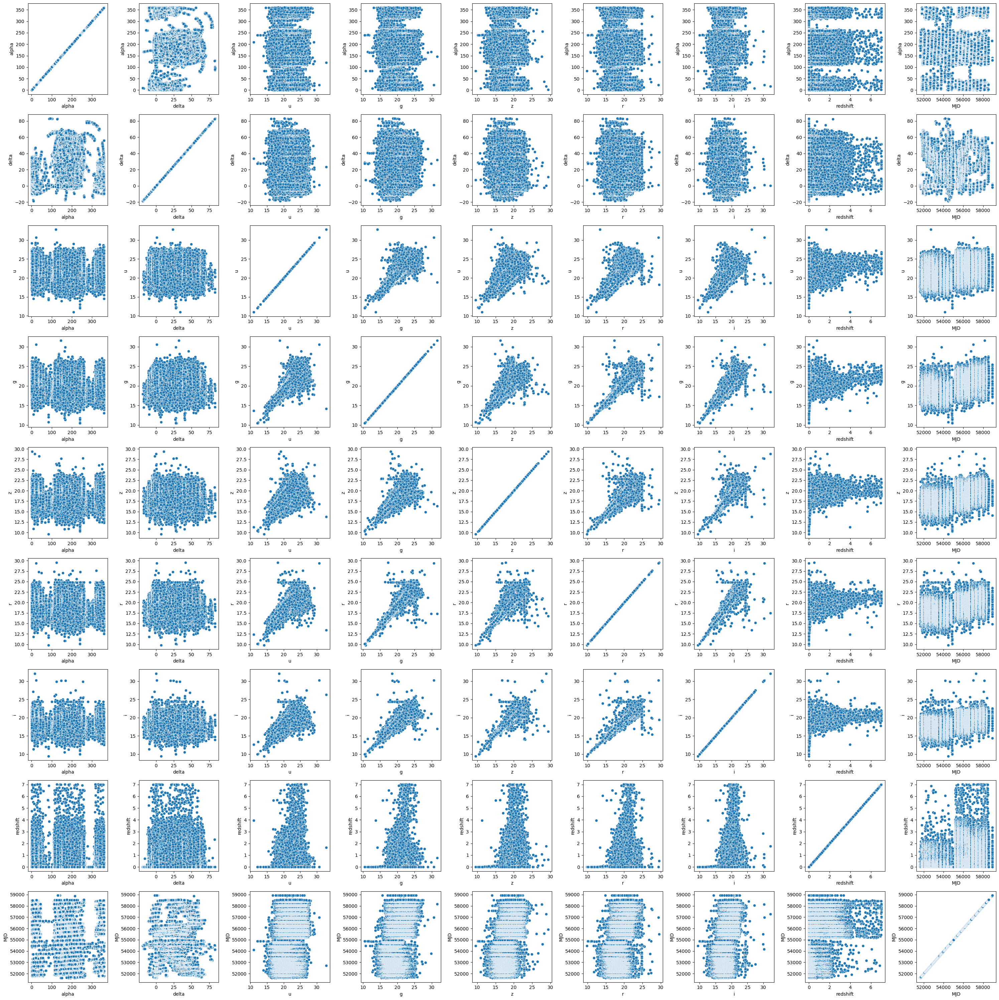

In [59]:
ax = 0
fig, axes = plt.subplots(nrows=9, ncols=9, figsize=(30,30))
axes = axes.flatten()
for num in numerical:
    for no in numerical:
        sns.scatterplot(data=df_1, x=no, y=num, ax=axes[ax])
        ax+=1
plt.tight_layout()
plt.show()

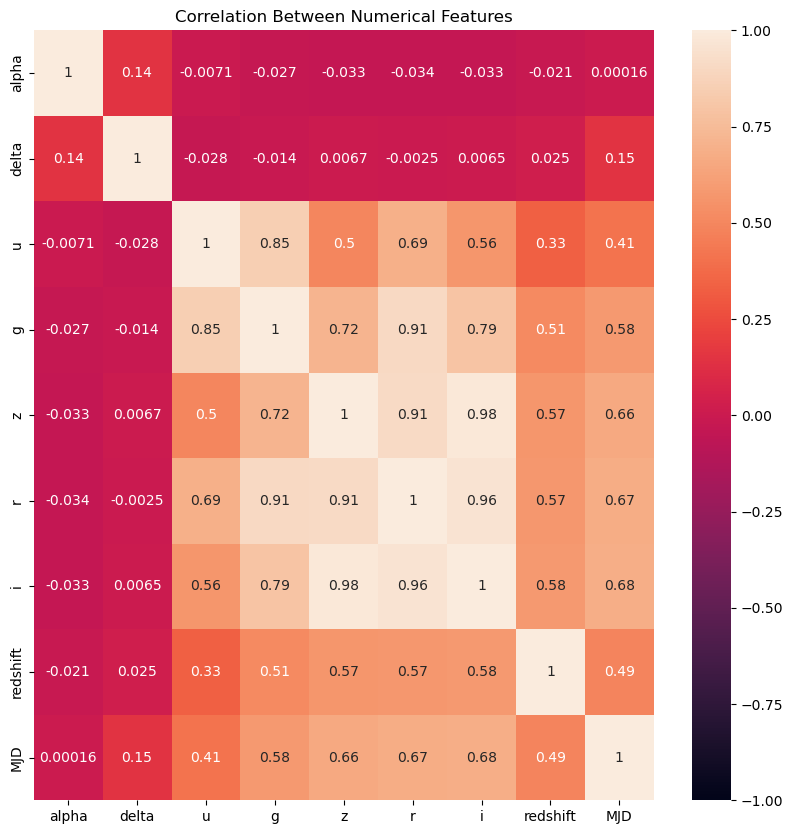

In [60]:
# Correlating Data

plt.figure(figsize=(10,10))
sns.heatmap(df_1[numerical].corr(method='spearman'),annot=True, vmin=-1, vmax=1)
plt.title('Correlation Between Numerical Features')
plt.show()

From the visualizations above, there are several findings listed below:
* There are high correlation between `u` and `g`, also in `z`, `r`, `i`; regularization will be done in the model.

#### Bivariate Analysis between Numerical and Categorical Variables

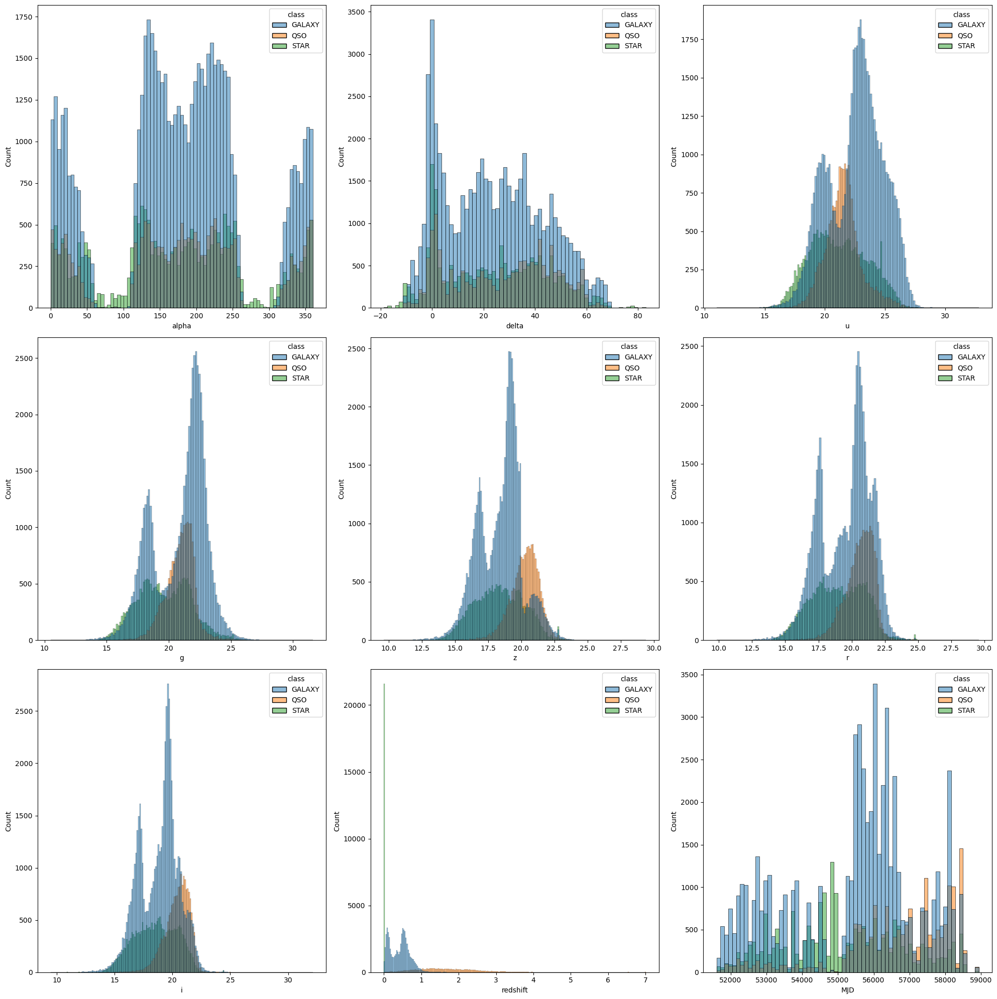

In [61]:
ax = 0
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(20,20))
axes = axes.flatten()
for num in numerical:
        sns.histplot(data=df_1, x=num, hue='class', ax=axes[ax])
        ax+=1
plt.tight_layout()
plt.show()

---
### Multivariate Analysis

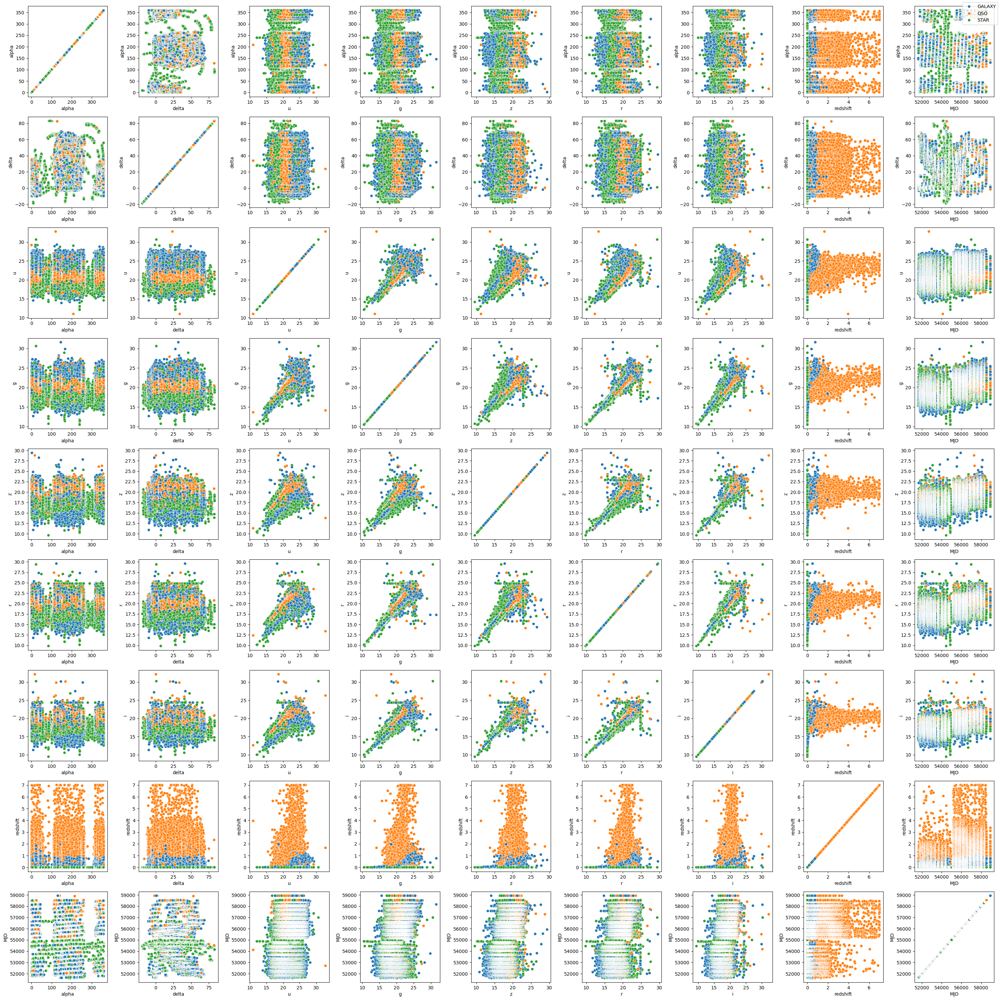

In [62]:
ax = 0
fig, axes = plt.subplots(nrows=9, ncols=9, figsize=(30,30))
axes = axes.flatten()
for num in numerical:
    for no in numerical:
        sns.scatterplot(data=df_1, x=no, y=num, hue='class', ax=axes[ax])
        ax+=1
handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels)
for axe in axes:
    axe.legend().remove()
plt.tight_layout()
plt.show()

---
---
# Modelling

---
## Feature Engineering

Feature engineering to be done:
* Data splitting to 80% train 20% test
* Column Transformers:
    - Applying logarithmic function (add first by one, then applying natural logarithmic) to `redshift`
* Robust Scaling

Since there are highly correlated features, as well as imbalanced target, resampling and regularization will be tested too in order to get the best performing model.

---
### Data Splitting

In [16]:
# Feature and target selection

X = df_1.drop(columns='class').copy()
y = df_1['class'].copy()

In [17]:
# Encoding Target
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
y = label_encoder.fit_transform(y)

print("Label Mapping: ", list(enumerate(label_encoder.classes_)))

Label Mapping:  [(0, 'GALAXY'), (1, 'QSO'), (2, 'STAR')]


In [18]:
# Splitting train data and test data

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

---
### Column Transformer

In [19]:
from sklearn.preprocessing import FunctionTransformer
from sklearn.compose import ColumnTransformer

# Making function to apply logarithmic transformation

def log_1(data):
    return np.log1p(data)

log_transformer = FunctionTransformer(log_1)

# Making column transformer
transformer = ColumnTransformer([
    ('Logarithmic', log_transformer, ['redshift'])
], remainder='passthrough')

---
## Building Model

---
### Finding Base Model

#### Cross Validating Base Models

In [20]:
# importing Library

from sklearn.linear_model import LogisticRegression, RidgeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from catboost import CatBoostClassifier

from sklearn.multiclass import OneVsOneClassifier, OneVsRestClassifier

In [124]:
# Make list of models

logreg = LogisticRegression(multi_class='multinomial', random_state=47)
knn = KNeighborsClassifier()
tree = DecisionTreeClassifier(random_state=47)
forest = RandomForestClassifier(random_state=47)
gradboost = GradientBoostingClassifier(random_state=47)
xgb = XGBClassifier()
cat = CatBoostClassifier()

models = [logreg, knn, tree, forest, gradboost, xgb, cat]

In [125]:
# Cross Validating using accuracy

from sklearn.model_selection import KFold, cross_val_score
from imblearn.pipeline import Pipeline
from sklearn.preprocessing import RobustScaler
from sklearn.metrics import accuracy_score, balanced_accuracy_score

acc = []
std = []

for model in models:
    # Define Cross Validation Strategy
    crossval = KFold(n_splits=5, shuffle=True, random_state=47)
    
    # If model is either logreg or knn, apply RobustScaler
    if model in [logreg, knn]:    
        estimator = Pipeline([
            ('transform', transformer),
            ('scaler', RobustScaler()),
            ('model', model)
        ])
    else:
        estimator = Pipeline([
            ('transform', transformer),
            ('model', model)
        ])
    
    # Perform Cross Validation
    scores = cross_val_score(estimator, X=X_train, y=y_train, scoring='balanced_accuracy')
    acc.append(np.mean(scores))
    std.append(np.std(scores))

Learning rate set to 0.097822
0:	learn: 0.9339388	total: 45.8ms	remaining: 45.8s
1:	learn: 0.8125165	total: 77.3ms	remaining: 38.6s
2:	learn: 0.7131545	total: 114ms	remaining: 38s
3:	learn: 0.6335581	total: 149ms	remaining: 37.1s
4:	learn: 0.5675173	total: 187ms	remaining: 37.3s
5:	learn: 0.5117236	total: 229ms	remaining: 37.9s
6:	learn: 0.4649637	total: 268ms	remaining: 37.9s
7:	learn: 0.4246419	total: 318ms	remaining: 39.4s
8:	learn: 0.3885745	total: 359ms	remaining: 39.5s
9:	learn: 0.3575268	total: 397ms	remaining: 39.3s
10:	learn: 0.3304284	total: 438ms	remaining: 39.4s
11:	learn: 0.3059976	total: 481ms	remaining: 39.6s
12:	learn: 0.2849720	total: 525ms	remaining: 39.9s
13:	learn: 0.2662407	total: 576ms	remaining: 40.6s
14:	learn: 0.2502338	total: 654ms	remaining: 42.9s
15:	learn: 0.2361088	total: 729ms	remaining: 44.8s
16:	learn: 0.2232160	total: 825ms	remaining: 47.7s
17:	learn: 0.2107438	total: 897ms	remaining: 48.9s
18:	learn: 0.2004874	total: 1.15s	remaining: 59.5s
19:	learn: 

In [126]:
# Dataframe of Crossval results

base_cv = pd.DataFrame(
                       {"Model": ['Logistic Regression', 'K-Nearest Neighbors', 'Decision Tree', 'Random Forest', 'Gradient Boost', 'XGBoost', 'CatBoost'],
                       "Average Balanced Accuracy":acc,
                       "Standard-Dev":std}
                       ).sort_values(by='Average Balanced Accuracy', ascending=False).reset_index(drop=True)

In [127]:
base_cv

,Model,Average Balanced Accuracy,Standard-Dev
0,CatBoost,0.972233,0.001188
1,Random Forest,0.971852,0.001406
2,XGBoost,0.969775,0.001365
3,Gradient Boost,0.967128,0.001512
4,Decision Tree,0.959371,0.001318
5,Logistic Regression,0.951816,0.002004
6,K-Nearest Neighbors,0.944511,0.002420


#### Cross Validating Model with Resampling

In this case, since each class overlap (even not greatly), the resampling method used is SMOTE + Tomek Links

In [128]:
from sklearn.model_selection import KFold, cross_val_score
from imblearn.pipeline import Pipeline
from sklearn.preprocessing import RobustScaler
from sklearn.metrics import accuracy_score, balanced_accuracy_score
from imblearn.combine import SMOTETomek

acc = []
std = []

for model in models:
    # Define Cross Validation Strategy
    crossval = KFold(n_splits=5, shuffle=True, random_state=47)
    
    # If model is either logreg or knn, apply RobustScaler
    if model in [logreg, knn]:    
        estimator = Pipeline([
            ('transform', transformer),
            ('resample', SMOTETomek()),
            ('scaler', RobustScaler()),
            ('model', model)
        ])
    else:
        estimator = Pipeline([
            ('transform', transformer),
            ('resample', SMOTETomek()),
            ('model', model)
        ])
    
    # Perform Cross Validation
    scores = cross_val_score(estimator, X=X_train, y=y_train, scoring='balanced_accuracy')
    acc.append(np.mean(scores))
    std.append(np.std(scores))

Learning rate set to 0.100642
0:	learn: 0.9250581	total: 42.5ms	remaining: 42.4s
1:	learn: 0.7985078	total: 80.5ms	remaining: 40.2s
2:	learn: 0.7007452	total: 118ms	remaining: 39.1s
3:	learn: 0.6189609	total: 158ms	remaining: 39.3s
4:	learn: 0.5514896	total: 207ms	remaining: 41.1s
5:	learn: 0.4953806	total: 251ms	remaining: 41.5s
6:	learn: 0.4472812	total: 296ms	remaining: 41.9s
7:	learn: 0.4051287	total: 338ms	remaining: 41.9s
8:	learn: 0.3693636	total: 375ms	remaining: 41.3s
9:	learn: 0.3383975	total: 413ms	remaining: 40.9s
10:	learn: 0.3106424	total: 458ms	remaining: 41.2s
11:	learn: 0.2868555	total: 498ms	remaining: 41s
12:	learn: 0.2648210	total: 537ms	remaining: 40.7s
13:	learn: 0.2456729	total: 574ms	remaining: 40.4s
14:	learn: 0.2293494	total: 612ms	remaining: 40.2s
15:	learn: 0.2148071	total: 652ms	remaining: 40.1s
16:	learn: 0.2010069	total: 691ms	remaining: 39.9s
17:	learn: 0.1892255	total: 736ms	remaining: 40.2s
18:	learn: 0.1779935	total: 777ms	remaining: 40.1s
19:	learn: 

In [129]:
# Dataframe of crossval results

smote_tomek_cv = pd.DataFrame(
    {"Model with SMOTE-Tomek Resampling":['Logistic Regression', 'K-Nearest Neighbors', 'Decision Tree', 'Random Forest', 'Gradient Boost', 'XGBoost', 'CatBoost'],
                       "Average Balanced Accuracy":acc,
                       "Standard-Dev": std}
                       ).sort_values(by='Average Balanced Accuracy', ascending=False).reset_index(drop=True)

In [130]:
smote_tomek_cv

,Model with SMOTE-Tomek Resampling,Average Balanced Accuracy,Standard-Dev
0,Random Forest,0.974234,0.001088
1,CatBoost,0.973302,0.000938
2,XGBoost,0.972444,0.001091
3,Gradient Boost,0.969733,0.000721
4,Decision Tree,0.963234,0.001898
5,Logistic Regression,0.952441,0.001422
6,K-Nearest Neighbors,0.944537,0.001687


#### Cross Validating Model with One-vs-One (Not Resampled)

In [131]:
ovo_logreg = OneVsOneClassifier(LogisticRegression(random_state=47))
ovo_knn = OneVsOneClassifier(KNeighborsClassifier())
ovo_tree = OneVsOneClassifier(DecisionTreeClassifier(random_state=47))
ovo_forest = OneVsOneClassifier(RandomForestClassifier(random_state=47))
ovo_gradboost = OneVsOneClassifier(GradientBoostingClassifier(random_state=47))
ovo_xgb = OneVsOneClassifier(XGBClassifier())
ovo_cat = OneVsOneClassifier(CatBoostClassifier())

ovo_models = [ovo_logreg, ovo_knn, ovo_tree, ovo_forest, ovo_gradboost, ovo_xgb, ovo_cat]

In [132]:
# Cross Validating using accuracy

from sklearn.model_selection import KFold, cross_val_score
from imblearn.pipeline import Pipeline
from sklearn.preprocessing import RobustScaler
from sklearn.metrics import accuracy_score, balanced_accuracy_score

acc = []
std = []

for model in ovo_models:
    # Define Cross Validation Strategy
    crossval = KFold(n_splits=5, shuffle=True, random_state=47)
    
    # If model is either logreg or knn, apply RobustScaler
    if model in [ovo_logreg, ovo_knn]:    
        estimator = Pipeline([
            ('transform', transformer),
            ('scaler', RobustScaler()),
            ('model', model)
        ])
    else:
        estimator = Pipeline([
            ('transform', transformer),
            ('model', model)
        ])
    
    # Perform Cross Validation
    scores = cross_val_score(estimator, X=X_train, y=y_train, scoring='balanced_accuracy')
    acc.append(np.mean(scores))
    std.append(np.std(scores))

Learning rate set to 0.054835
0:	learn: 0.6028803	total: 38.7ms	remaining: 38.6s
1:	learn: 0.5258071	total: 77.6ms	remaining: 38.7s
2:	learn: 0.4607060	total: 115ms	remaining: 38.3s
3:	learn: 0.4070624	total: 154ms	remaining: 38.5s
4:	learn: 0.3632400	total: 188ms	remaining: 37.4s
5:	learn: 0.3262876	total: 232ms	remaining: 38.4s
6:	learn: 0.2948082	total: 285ms	remaining: 40.4s
7:	learn: 0.2699775	total: 328ms	remaining: 40.7s
8:	learn: 0.2456119	total: 375ms	remaining: 41.3s
9:	learn: 0.2255357	total: 427ms	remaining: 42.3s
10:	learn: 0.2090370	total: 483ms	remaining: 43.4s
11:	learn: 0.1943542	total: 541ms	remaining: 44.6s
12:	learn: 0.1816888	total: 610ms	remaining: 46.3s
13:	learn: 0.1719513	total: 667ms	remaining: 47s
14:	learn: 0.1634279	total: 742ms	remaining: 48.7s
15:	learn: 0.1554016	total: 801ms	remaining: 49.3s
16:	learn: 0.1486542	total: 867ms	remaining: 50.1s
17:	learn: 0.1432929	total: 947ms	remaining: 51.7s
18:	learn: 0.1381965	total: 1.02s	remaining: 52.6s
19:	learn: 

In [133]:
# Dataframe of crossval results

one_vs_one = pd.DataFrame(
    {"Model with One vs One Classifier":['Logistic Regression', 'K-Nearest Neighbors', 'Decision Tree', 'Random Forest', 'Gradient Boost', 'XGBoost', 'CatBoost'],
                       "Average Balanced Accuracy":acc,
                       "Standard-Dev": std}
                       ).sort_values(by='Average Balanced Accuracy', ascending=False).reset_index(drop=True)

In [134]:
one_vs_one

,Model with One vs One Classifier,Average Balanced Accuracy,Standard-Dev
0,CatBoost,0.972793,0.000949
1,Random Forest,0.972336,0.001572
2,XGBoost,0.970680,0.001565
3,Gradient Boost,0.966349,0.001703
4,Decision Tree,0.959629,0.001148
5,Logistic Regression,0.951865,0.001848
6,K-Nearest Neighbors,0.944470,0.002534


#### Cross Validating Model with One-vs-One, Resampled

In [135]:
from sklearn.model_selection import KFold, cross_val_score
from imblearn.pipeline import Pipeline
from sklearn.preprocessing import RobustScaler
from sklearn.metrics import accuracy_score, balanced_accuracy_score
from imblearn.combine import SMOTETomek

acc = []
std = []

for model in ovo_models:
    # Define Cross Validation Strategy
    crossval = KFold(n_splits=5, shuffle=True, random_state=47)
    
    # If model is either logreg or knn, apply RobustScaler
    if model in [ovo_logreg, ovo_knn]:    
        estimator = Pipeline([
            ('transform', transformer),
            ('resample', SMOTETomek()),
            ('scaler', RobustScaler()),
            ('model', model)
        ])
    else:
        estimator = Pipeline([
            ('transform', transformer),
            ('resample', SMOTETomek()),
            ('model', model)
        ])
    
    # Perform Cross Validation
    scores = cross_val_score(estimator, X=X_train, y=y_train, scoring='balanced_accuracy')
    acc.append(np.mean(scores))
    std.append(np.std(scores))

Learning rate set to 0.0649
0:	learn: 0.5777771	total: 25.8ms	remaining: 25.8s
1:	learn: 0.4874114	total: 59.3ms	remaining: 29.6s
2:	learn: 0.4123567	total: 93.8ms	remaining: 31.2s
3:	learn: 0.3556789	total: 133ms	remaining: 33.1s
4:	learn: 0.3128045	total: 175ms	remaining: 34.8s
5:	learn: 0.2776177	total: 220ms	remaining: 36.4s
6:	learn: 0.2510802	total: 265ms	remaining: 37.5s
7:	learn: 0.2297278	total: 305ms	remaining: 37.8s
8:	learn: 0.2099444	total: 340ms	remaining: 37.4s
9:	learn: 0.1926310	total: 381ms	remaining: 37.7s
10:	learn: 0.1772297	total: 419ms	remaining: 37.7s
11:	learn: 0.1661418	total: 462ms	remaining: 38s
12:	learn: 0.1562595	total: 502ms	remaining: 38.1s
13:	learn: 0.1483074	total: 542ms	remaining: 38.2s
14:	learn: 0.1422027	total: 579ms	remaining: 38s
15:	learn: 0.1366612	total: 618ms	remaining: 38s
16:	learn: 0.1324764	total: 654ms	remaining: 37.8s
17:	learn: 0.1282562	total: 696ms	remaining: 38s
18:	learn: 0.1242509	total: 736ms	remaining: 38s
19:	learn: 0.1214619

In [136]:
# Dataframe of crossval results

one_vs_one_resam = pd.DataFrame(
    {"Model with One vs One Classifier, Resampled":['Logistic Regression', 'K-Nearest Neighbors', 'Decision Tree', 'Random Forest', 'Gradient Boost', 'XGBoost', 'CatBoost'],
                       "Average Balanced Accuracy":acc,
                       "Standard-Dev": std}
                       ).sort_values(by='Average Balanced Accuracy', ascending=False).reset_index(drop=True)

In [137]:
one_vs_one_resam

,"Model with One vs One Classifier, Resampled",Average Balanced Accuracy,Standard-Dev
0,Random Forest,0.974311,0.000892
1,CatBoost,0.973711,0.001022
2,XGBoost,0.972457,0.001751
3,Gradient Boost,0.969813,0.000971
4,Decision Tree,0.963859,0.001916
5,Logistic Regression,0.952363,0.001337
6,K-Nearest Neighbors,0.944560,0.001461


#### Cross Validating Model with One-vs-Rest (Not Resampled)

In [138]:
ovr_logreg = OneVsRestClassifier(LogisticRegression(random_state=47))
ovr_knn = OneVsRestClassifier(KNeighborsClassifier())
ovr_tree = OneVsRestClassifier(DecisionTreeClassifier(random_state=47))
ovr_forest = OneVsRestClassifier(RandomForestClassifier(random_state=47))
ovr_gradboost = OneVsRestClassifier(GradientBoostingClassifier(random_state=47))
ovr_xgb = OneVsRestClassifier(XGBClassifier())
ovr_cat = OneVsRestClassifier(CatBoostClassifier())

ovr_models = [ovr_logreg, ovr_knn, ovr_tree, ovr_forest, ovr_gradboost, ovr_xgb, ovr_cat]

In [139]:
# Cross Validating using accuracy

from sklearn.model_selection import KFold, cross_val_score
from imblearn.pipeline import Pipeline
from sklearn.preprocessing import RobustScaler
from sklearn.metrics import accuracy_score, balanced_accuracy_score

acc = []
std = []

for model in ovr_models:
    # Define Cross Validation Strategy
    crossval = KFold(n_splits=5, shuffle=True, random_state=47)
    
    # If model is either logreg or knn, apply RobustScaler
    if model in [ovr_logreg, ovr_knn]:    
        estimator = Pipeline([
            ('transform', transformer),
            ('scaler', RobustScaler()),
            ('model', model)
        ])
    else:
        estimator = Pipeline([
            ('transform', transformer),
            ('model', model)
        ])
    
    # Perform Cross Validation
    scores = cross_val_score(estimator, X=X_train, y=y_train, scoring='balanced_accuracy')
    acc.append(np.mean(scores))
    std.append(np.std(scores))

Learning rate set to 0.060837
0:	learn: 0.5913152	total: 22ms	remaining: 22s
1:	learn: 0.5092820	total: 42.4ms	remaining: 21.2s
2:	learn: 0.4411751	total: 62.7ms	remaining: 20.8s
3:	learn: 0.3858477	total: 83.6ms	remaining: 20.8s
4:	learn: 0.3451676	total: 105ms	remaining: 21s
5:	learn: 0.3108162	total: 125ms	remaining: 20.8s
6:	learn: 0.2802028	total: 146ms	remaining: 20.7s
7:	learn: 0.2548149	total: 166ms	remaining: 20.6s
8:	learn: 0.2322311	total: 188ms	remaining: 20.7s
9:	learn: 0.2158423	total: 210ms	remaining: 20.8s
10:	learn: 0.2010312	total: 237ms	remaining: 21.3s
11:	learn: 0.1886473	total: 264ms	remaining: 21.7s
12:	learn: 0.1778648	total: 292ms	remaining: 22.2s
13:	learn: 0.1686504	total: 320ms	remaining: 22.5s
14:	learn: 0.1610500	total: 351ms	remaining: 23s
15:	learn: 0.1549867	total: 377ms	remaining: 23.2s
16:	learn: 0.1491824	total: 406ms	remaining: 23.5s
17:	learn: 0.1440220	total: 437ms	remaining: 23.8s
18:	learn: 0.1395784	total: 467ms	remaining: 24.1s
19:	learn: 0.13

In [140]:
# Dataframe of crossval results

one_vs_rest = pd.DataFrame(
    {"Model with One-vs-Rest Classifier":['Logistic Regression', 'K-Nearest Neighbors', 'Decision Tree', 'Random Forest', 'Gradient Boost', 'XGBoost', 'CatBoost'],
                       "Average Balanced Accuracy":acc,
                       "Standard-Dev": std}
                       ).sort_values(by='Average Balanced Accuracy', ascending=False).reset_index(drop=True)

In [141]:
one_vs_rest

,Model with One-vs-Rest Classifier,Average Balanced Accuracy,Standard-Dev
0,Random Forest,0.972388,0.001364
1,CatBoost,0.972289,0.001003
2,XGBoost,0.969707,0.001032
3,Gradient Boost,0.966379,0.001873
4,Decision Tree,0.955584,0.000976
5,K-Nearest Neighbors,0.944522,0.002545
6,Logistic Regression,0.935757,0.002843


#### Cross Validating Model with One-vs-Rest, Resampled

In [142]:
from sklearn.model_selection import KFold, cross_val_score
from imblearn.pipeline import Pipeline
from sklearn.preprocessing import RobustScaler
from sklearn.metrics import accuracy_score, balanced_accuracy_score
from imblearn.combine import SMOTETomek

acc = []
std = []

for model in ovr_models:
    # Define Cross Validation Strategy
    crossval = KFold(n_splits=5, shuffle=True, random_state=47)
    
    # If model is either logreg or knn, apply RobustScaler
    if model in [ovr_logreg, ovr_knn]:    
        estimator = Pipeline([
            ('transform', transformer),
            ('resample', SMOTETomek()),
            ('scaler', RobustScaler()),
            ('model', model)
        ])
    else:
        estimator = Pipeline([
            ('transform', transformer),
            ('resample', SMOTETomek()),
            ('model', model)
        ])
    
    # Perform Cross Validation
    scores = cross_val_score(estimator, X=X_train, y=y_train, scoring='balanced_accuracy')
    acc.append(np.mean(scores))
    std.append(np.std(scores))

Learning rate set to 0.077171
0:	learn: 0.5508206	total: 29.1ms	remaining: 29.1s
1:	learn: 0.4501958	total: 61.4ms	remaining: 30.7s
2:	learn: 0.3661904	total: 94.3ms	remaining: 31.4s
3:	learn: 0.3055030	total: 130ms	remaining: 32.4s
4:	learn: 0.2582623	total: 165ms	remaining: 32.8s
5:	learn: 0.2238172	total: 201ms	remaining: 33.3s
6:	learn: 0.1976173	total: 242ms	remaining: 34.3s
7:	learn: 0.1769860	total: 283ms	remaining: 35.1s
8:	learn: 0.1614229	total: 330ms	remaining: 36.4s
9:	learn: 0.1488169	total: 382ms	remaining: 37.8s
10:	learn: 0.1387319	total: 428ms	remaining: 38.5s
11:	learn: 0.1310903	total: 486ms	remaining: 40s
12:	learn: 0.1248922	total: 531ms	remaining: 40.3s
13:	learn: 0.1201760	total: 581ms	remaining: 40.9s
14:	learn: 0.1157733	total: 623ms	remaining: 40.9s
15:	learn: 0.1103115	total: 669ms	remaining: 41.1s
16:	learn: 0.1077401	total: 714ms	remaining: 41.3s
17:	learn: 0.1042194	total: 759ms	remaining: 41.4s
18:	learn: 0.1013302	total: 801ms	remaining: 41.3s
19:	learn:

In [143]:
# Dataframe of crossval results

one_vs_rest_resam = pd.DataFrame(
    {"Model with One-vs-Rest Classifier, Resampled":['Logistic Regression', 'K-Nearest Neighbors', 'Decision Tree', 'Random Forest', 'Gradient Boost', 'XGBoost', 'CatBoost'],
                       "Average Balanced Accuracy":acc,
                       "Standard-Dev":std}
                       ).sort_values(by='Average Balanced Accuracy', ascending=False).reset_index(drop=True)

In [144]:
one_vs_rest_resam

,"Model with One-vs-Rest Classifier, Resampled",Average Balanced Accuracy,Standard-Dev
0,Random Forest,0.974655,0.001010
1,CatBoost,0.973160,0.000397
2,XGBoost,0.972635,0.000858
3,Gradient Boost,0.969401,0.001054
4,Decision Tree,0.956612,0.001349
5,K-Nearest Neighbors,0.944391,0.001276
6,Logistic Regression,0.940035,0.001085


#### Comparing Cross Validation Results

In [145]:
cv_results = pd.DataFrame(
    {'Model': ['CatBoost', 'Random Forest with Resample', 'CatBoost OvO', 'Random Forest OvO with Resample', 'Random Forest OVR', 'Random Forest OVR with Resample'],
     'Average Balanced Accuracy': [base_cv['Average Balanced Accuracy'][0], smote_tomek_cv['Average Balanced Accuracy'][0], one_vs_one['Average Balanced Accuracy'][0], one_vs_one_resam['Average Balanced Accuracy'][0], one_vs_rest['Average Balanced Accuracy'][0], one_vs_rest_resam['Average Balanced Accuracy'][0]],
     'Standard-Dev': [base_cv['Standard-Dev'][0], smote_tomek_cv['Standard-Dev'][0], one_vs_one['Standard-Dev'][0], one_vs_one_resam['Standard-Dev'][0], one_vs_rest['Standard-Dev'][0], one_vs_rest_resam['Standard-Dev'][0]]}
)

In [146]:
cv_results.sort_values('Average Balanced Accuracy', ascending=False)

,Model,Average Balanced Accuracy,Standard-Dev
5,Random Forest OVR with Resample,0.974655,0.001010
3,Random Forest OvO with Resample,0.974311,0.000892
1,Random Forest with Resample,0.974234,0.001088
2,CatBoost OvO,0.972793,0.000949
4,Random Forest OVR,0.972388,0.001364
0,CatBoost,0.972233,0.001188


Based on this results, the chosen model is Random Forest One-vs-One with SMOTE-Tomek Link resample method. However, due to limited computational resource, the second best option of CatBoost One-vs-One with SMOTE-Tomek Link resample method is chosen.

---
### Testing Base Model

In [28]:
from catboost import CatBoostClassifier
from sklearn.multiclass import OneVsOneClassifier

cat_ovo = OneVsOneClassifier(CatBoostClassifier())

In [29]:
from imblearn.combine import SMOTETomek
from imblearn.pipeline import Pipeline

estimator = Pipeline([
    ('transform', transformer),
    ('resampling', SMOTETomek()),
    ('clf', cat_ovo)
])

In [30]:
# Fitting base model to train data

estimator.fit(X_train, y_train)

Learning rate set to 0.071429
0:	learn: 0.5676093	total: 147ms	remaining: 2m 27s
1:	learn: 0.4699240	total: 170ms	remaining: 1m 24s
2:	learn: 0.3922532	total: 193ms	remaining: 1m 4s
3:	learn: 0.3346953	total: 223ms	remaining: 55.6s
4:	learn: 0.2878805	total: 251ms	remaining: 50s
5:	learn: 0.2569062	total: 279ms	remaining: 46.2s
6:	learn: 0.2315181	total: 299ms	remaining: 42.4s
7:	learn: 0.2077623	total: 318ms	remaining: 39.5s
8:	learn: 0.1894514	total: 342ms	remaining: 37.6s
9:	learn: 0.1759940	total: 362ms	remaining: 35.9s
10:	learn: 0.1636286	total: 384ms	remaining: 34.5s
11:	learn: 0.1541256	total: 411ms	remaining: 33.8s
12:	learn: 0.1469307	total: 437ms	remaining: 33.2s
13:	learn: 0.1397115	total: 464ms	remaining: 32.7s
14:	learn: 0.1339901	total: 488ms	remaining: 32s
15:	learn: 0.1292602	total: 513ms	remaining: 31.6s
16:	learn: 0.1249512	total: 541ms	remaining: 31.3s
17:	learn: 0.1206316	total: 565ms	remaining: 30.8s
18:	learn: 0.1173221	total: 590ms	remaining: 30.5s
19:	learn: 0.

Pipeline(steps=[('transform',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('Logarithmic',
                                                  FunctionTransformer(func=<function log_1 at 0x00000286A1C7AFC0>),
                                                  ['redshift'])])),
                ('resampling', SMOTETomek()),
                ('clf',
                 OneVsOneClassifier(estimator=<catboost.core.CatBoostClassifier object at 0x00000286A897BE10>))])

Model Accuracy: 0.977
              precision    recall  f1-score   support

           0       0.98      0.98      0.98     11889
           1       0.94      0.95      0.94      3792
           2       0.99      1.00      1.00      4319

    accuracy                           0.98     20000
   macro avg       0.97      0.97      0.97     20000
weighted avg       0.98      0.98      0.98     20000



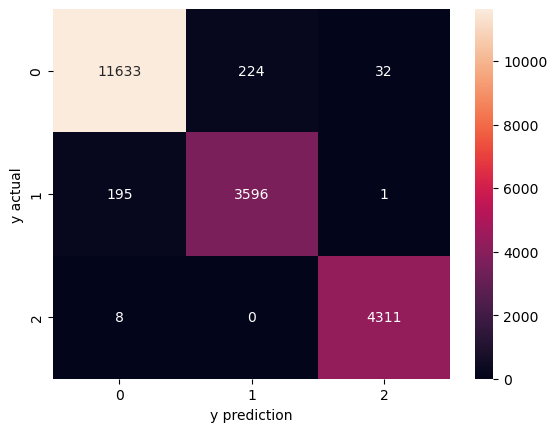

In [34]:
# Predicting with Base Model
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay

y_predict_base = estimator.predict(X_test)

# Print accuracy
print("Model Accuracy:", accuracy_score(y_test, y_predict_base))

# Print Classification Report
print(classification_report(y_test, y_predict_base))

# Display confusion matrix
sns.heatmap(confusion_matrix(y_test, y_predict_base), annot=True, fmt='.0f')
plt.xlabel('y prediction')
plt.ylabel('y actual')
plt.show()

---
### Hyperparameter Tuning

In [21]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.multiclass import OneVsOneClassifier

cat_ovo = OneVsOneClassifier(CatBoostClassifier())

In [23]:
from imblearn.combine import SMOTETomek
from imblearn.pipeline import Pipeline

estimator = Pipeline([
    ('transform', transformer),
    ('resampling', SMOTETomek()),
    ('clf', cat_ovo)
])

In [26]:
hyperparam = {
    'resampling__sampling_strategy': ['auto', 0.9, 0.8, 0.7],   # Different strategies for SMOTETomek
    'clf__estimator__depth': np.arange(4, 11),                  # CatBoost tree depth
    'clf__estimator__learning_rate': [0.01, 0.1, 0.2, 0.3],     # Learning rates from 0.001 to 1
    'clf__estimator__iterations': np.arange(100, 200, 300),     # CatBoost iterations
    'clf__estimator__l2_leaf_reg': np.logspace(-3, 2, 6),       # L2 regularization
    'clf__estimator__border_count': np.arange(32, 255, 32),     # Border count (used in CatBoost)
    'clf__estimator__bagging_temperature': np.linspace(0, 1, 5) # Bagging temperature
}

In [35]:
# cross validation for hyperparameter tuning

from sklearn.model_selection import KFold, RandomizedSearchCV

crossval = KFold(n_splits=5, shuffle=True, random_state=47)

grid_search = RandomizedSearchCV(
    estimator,
    param_distributions=hyperparam,
    cv=crossval,
    scoring='balanced_accuracy',
    n_iter=100,
    n_jobs=-1
)

# Fit grid search
grid_search.fit(X_train, y_train)

0:	learn: 0.4750784	total: 20.8ms	remaining: 2.06s
1:	learn: 0.3510017	total: 39.7ms	remaining: 1.95s
2:	learn: 0.2726088	total: 58.1ms	remaining: 1.88s
3:	learn: 0.2208216	total: 78.2ms	remaining: 1.88s
4:	learn: 0.1855325	total: 98ms	remaining: 1.86s
5:	learn: 0.1618773	total: 117ms	remaining: 1.83s
6:	learn: 0.1436260	total: 136ms	remaining: 1.8s
7:	learn: 0.1279716	total: 156ms	remaining: 1.79s
8:	learn: 0.1180990	total: 174ms	remaining: 1.76s
9:	learn: 0.1100107	total: 193ms	remaining: 1.73s
10:	learn: 0.1048156	total: 212ms	remaining: 1.71s
11:	learn: 0.1007926	total: 232ms	remaining: 1.7s
12:	learn: 0.0978916	total: 254ms	remaining: 1.7s
13:	learn: 0.0953225	total: 275ms	remaining: 1.69s
14:	learn: 0.0932538	total: 296ms	remaining: 1.67s
15:	learn: 0.0914753	total: 321ms	remaining: 1.68s
16:	learn: 0.0898638	total: 349ms	remaining: 1.7s
17:	learn: 0.0888353	total: 381ms	remaining: 1.74s
18:	learn: 0.0878349	total: 410ms	remaining: 1.75s
19:	learn: 0.0868605	total: 433ms	remainin

RandomizedSearchCV(cv=KFold(n_splits=5, random_state=47, shuffle=True),
                   estimator=Pipeline(steps=[('transform',
                                              ColumnTransformer(remainder='passthrough',
                                                                transformers=[('Logarithmic',
                                                                               FunctionTransformer(func=<function log_1 at 0x00000286A1C7AFC0>),
                                                                               ['redshift'])])),
                                             ('resampling', SMOTETomek()),
                                             ('clf',
                                              OneVsOneClassifier(estimator=<catboost.core.CatBoostClass...
                                        'clf__estimator__border_count': array([ 32,  64,  96, 128, 160, 192, 224]),
                                        'clf__estimator__depth': array([ 4,  5,  6,  7,  8,  9, 10]),
                                        'clf__estimator__iterations': array([100]),
                                        'clf__estimator__l2_leaf_reg': array([1.e-03, 1.e-02, 1.e-01, 1.e+00, 1.e+01, 1.e+02]),
                                        'clf__estimator__learning_rate': [0.01,
                                                                          0.1,
                                                                          0.2,
                                                                          0.3],
                                        'resampling__sampling_strategy': ['auto',
                                                                          0.9,
                                                                          0.8,
                                                                          0.7]},
                   scoring='balanced_accuracy')

In [36]:
# Print best score and params

print('Hyperparameter Results')
print('Best Balanced Accuracy Score:', grid_search.best_score_.round(3))
print('Best Model Parameter:', grid_search.best_params_)

Hyperparameter Results
Best Balanced Accuracy Score: 0.973
Best Model Parameter: {'resampling__sampling_strategy': 'auto', 'clf__estimator__learning_rate': 0.3, 'clf__estimator__l2_leaf_reg': 10.0, 'clf__estimator__iterations': 100, 'clf__estimator__depth': 8, 'clf__estimator__border_count': 192, 'clf__estimator__bagging_temperature': 0.25}


#### Predicting Using Hyperparameter Tuned Model

In [37]:
# Fitting best estimator

tuned_model = grid_search.best_estimator_
tuned_model.fit(X_train, y_train)

0:	learn: 0.4765839	total: 20.2ms	remaining: 2s
1:	learn: 0.3548424	total: 38ms	remaining: 1.86s
2:	learn: 0.2760357	total: 57.3ms	remaining: 1.85s
3:	learn: 0.2223334	total: 74.7ms	remaining: 1.79s
4:	learn: 0.1874447	total: 92.9ms	remaining: 1.76s
5:	learn: 0.1604431	total: 111ms	remaining: 1.74s
6:	learn: 0.1419519	total: 131ms	remaining: 1.73s
7:	learn: 0.1279778	total: 150ms	remaining: 1.72s
8:	learn: 0.1183241	total: 168ms	remaining: 1.7s
9:	learn: 0.1104946	total: 187ms	remaining: 1.68s
10:	learn: 0.1055520	total: 205ms	remaining: 1.66s
11:	learn: 0.1008707	total: 222ms	remaining: 1.63s
12:	learn: 0.0980335	total: 241ms	remaining: 1.61s
13:	learn: 0.0950303	total: 265ms	remaining: 1.63s
14:	learn: 0.0927804	total: 287ms	remaining: 1.63s
15:	learn: 0.0913108	total: 305ms	remaining: 1.6s
16:	learn: 0.0898587	total: 323ms	remaining: 1.58s
17:	learn: 0.0886304	total: 340ms	remaining: 1.55s
18:	learn: 0.0875715	total: 357ms	remaining: 1.52s
19:	learn: 0.0864787	total: 375ms	remaining

Pipeline(steps=[('transform',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('Logarithmic',
                                                  FunctionTransformer(func=<function log_1 at 0x00000286A1C7AFC0>),
                                                  ['redshift'])])),
                ('resampling', SMOTETomek()),
                ('clf',
                 OneVsOneClassifier(estimator=<catboost.core.CatBoostClassifier object at 0x00000286A7D6DA50>))])

In [38]:
# Predicting Test Set

y_predict_tuned = tuned_model.predict(X_test)

---
### Model Evaluation



In [44]:
print('Base Catboost Model Using One-vs-One Classifier and SMOTE-Tomek Resampler:', round(accuracy_score(y_test, y_predict_base),3))
print('Tuned Catboost Model Using One-vs-One Classifier and SMOTE-Tomek Resampler:', round(accuracy_score(y_test, y_predict_tuned),3))

Base Catboost Model Using One-vs-One Classifier and SMOTE-Tomek Resampler: 0.977
Tuned Catboost Model Using One-vs-One Classifier and SMOTE-Tomek Resampler: 0.975


In [45]:
print('Base Catboost Model Using One-vs-One Classifier and SMOTE-Tomek Resampler Classification Report')
print(classification_report(y_test, y_predict_base))

print('\nTuned Catboost Model Using One-vs-One Classifier and SMOTE-Tomek Resampler Classification Report')
print(classification_report(y_test, y_predict_tuned))

Base Catboost Model Using One-vs-One Classifier and SMOTE-Tomek Resampler Classification Report
              precision    recall  f1-score   support

           0       0.98      0.98      0.98     11889
           1       0.94      0.95      0.94      3792
           2       0.99      1.00      1.00      4319

    accuracy                           0.98     20000
   macro avg       0.97      0.97      0.97     20000
weighted avg       0.98      0.98      0.98     20000


Tuned Catboost Model Using One-vs-One Classifier and SMOTE-Tomek Resampler Classification Report
              precision    recall  f1-score   support

           0       0.98      0.98      0.98     11889
           1       0.93      0.95      0.94      3792
           2       0.99      1.00      1.00      4319

    accuracy                           0.97     20000
   macro avg       0.97      0.97      0.97     20000
weighted avg       0.97      0.97      0.97     20000



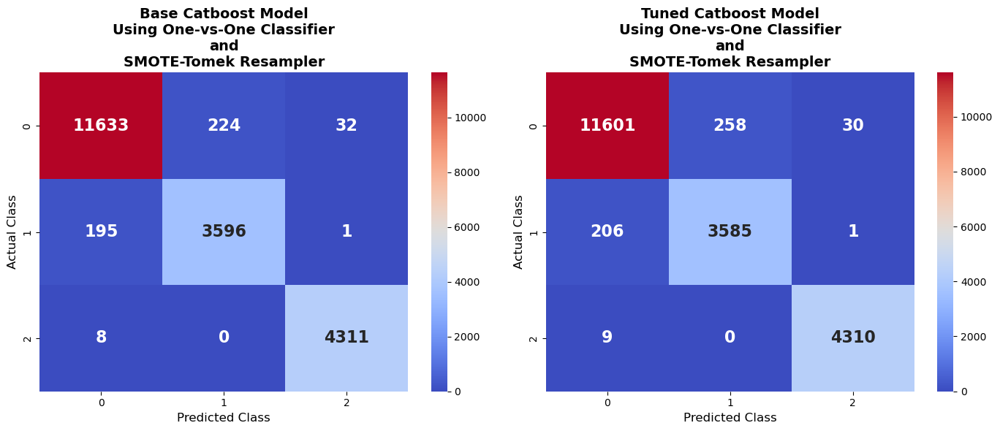

In [49]:
plt.figure(figsize=(14,6))

# matrix base catboost
plt.subplot(1,2,1)
sns.heatmap(confusion_matrix(y_test, y_predict_base), annot=True, fmt='.0f',cmap='coolwarm', annot_kws={'size': 16, 'weight': 'bold'})
plt.xlabel('Predicted Class', fontsize=12)
plt.ylabel('Actual Class', fontsize=12)
plt.title('Base Catboost Model\nUsing One-vs-One Classifier\nand\nSMOTE-Tomek Resampler', size=14, fontweight='bold')

# matrix tuned catboost
plt.subplot(1,2,2)
sns.heatmap(confusion_matrix(y_test, y_predict_tuned), annot=True, fmt='.0f',cmap='coolwarm', annot_kws={'size': 16, 'weight': 'bold'})
plt.xlabel('Predicted Class', fontsize=12)
plt.ylabel('Actual Class', fontsize=12)
plt.title('Tuned Catboost Model\nUsing One-vs-One Classifier\nand\nSMOTE-Tomek Resampler', size=14, fontweight='bold')

plt.tight_layout()
plt.show()

Based on this result, where the base model works slightly better than the tuned model, the base model of Catboost with One-vs-One Classifier and SMOTE-Tomek resampler is chosen for this dataset.

---
## Save Model

In [56]:
from catboost import CatBoostClassifier
from sklearn.multiclass import OneVsOneClassifier
from imblearn.combine import SMOTETomek
from imblearn.pipeline import Pipeline

# refit model

cat_ovo = OneVsOneClassifier(CatBoostClassifier())

estimator = Pipeline([
    ('transform', transformer),
    ('resampling', SMOTETomek()),
    ('clf', cat_ovo)
])

estimator.fit(X_train, y_train)

Learning rate set to 0.071477
0:	learn: 0.5730533	total: 42.5ms	remaining: 42.5s
1:	learn: 0.4708530	total: 77.2ms	remaining: 38.5s
2:	learn: 0.3956417	total: 105ms	remaining: 34.8s
3:	learn: 0.3393350	total: 136ms	remaining: 33.8s
4:	learn: 0.2939109	total: 168ms	remaining: 33.5s
5:	learn: 0.2612055	total: 196ms	remaining: 32.5s
6:	learn: 0.2343653	total: 236ms	remaining: 33.5s
7:	learn: 0.2133834	total: 290ms	remaining: 35.9s
8:	learn: 0.1936045	total: 330ms	remaining: 36.3s
9:	learn: 0.1792819	total: 360ms	remaining: 35.6s
10:	learn: 0.1662677	total: 393ms	remaining: 35.3s
11:	learn: 0.1564808	total: 423ms	remaining: 34.8s
12:	learn: 0.1483903	total: 452ms	remaining: 34.3s
13:	learn: 0.1410379	total: 482ms	remaining: 33.9s
14:	learn: 0.1348155	total: 530ms	remaining: 34.8s
15:	learn: 0.1293538	total: 574ms	remaining: 35.3s
16:	learn: 0.1256595	total: 608ms	remaining: 35.1s
17:	learn: 0.1223233	total: 646ms	remaining: 35.2s
18:	learn: 0.1185865	total: 679ms	remaining: 35.1s
19:	learn

Pipeline(steps=[('transform',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('Logarithmic',
                                                  FunctionTransformer(func=<function log_1 at 0x00000286A1C7AFC0>),
                                                  ['redshift'])])),
                ('resampling', SMOTETomek()),
                ('clf',
                 OneVsOneClassifier(estimator=<catboost.core.CatBoostClassifier object at 0x00000286B11F1ED0>))])

In [59]:
import pickle

# save model
best_model = estimator
save_model = best_model.fit(X,y)
file_name = 'stellar_classification_model.sav'
pickle.dump(save_model, open(file_name, 'wb'))

Learning rate set to 0.078651
0:	learn: 0.5564830	total: 31.4ms	remaining: 31.4s
1:	learn: 0.4542275	total: 61.9ms	remaining: 30.9s
2:	learn: 0.3784434	total: 99.5ms	remaining: 33.1s
3:	learn: 0.3207284	total: 130ms	remaining: 32.4s
4:	learn: 0.2742746	total: 157ms	remaining: 31.3s
5:	learn: 0.2383020	total: 188ms	remaining: 31.1s
6:	learn: 0.2112933	total: 219ms	remaining: 31s
7:	learn: 0.1913324	total: 251ms	remaining: 31.1s
8:	learn: 0.1754388	total: 281ms	remaining: 30.9s
9:	learn: 0.1647345	total: 307ms	remaining: 30.4s
10:	learn: 0.1536088	total: 333ms	remaining: 29.9s
11:	learn: 0.1451393	total: 362ms	remaining: 29.8s
12:	learn: 0.1378178	total: 392ms	remaining: 29.7s
13:	learn: 0.1323894	total: 425ms	remaining: 29.9s
14:	learn: 0.1278015	total: 452ms	remaining: 29.7s
15:	learn: 0.1236411	total: 482ms	remaining: 29.6s
16:	learn: 0.1198163	total: 516ms	remaining: 29.8s
17:	learn: 0.1163273	total: 549ms	remaining: 29.9s
18:	learn: 0.1140962	total: 581ms	remaining: 30s
19:	learn: 0